<a href="https://colab.research.google.com/github/Tinnapat1406/Yolo11n_Fish_Detection/blob/main/fishYolo11n.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [10]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Task
Train a YOLO11n model on a custom COCO fish dataset.

**Install ultralytics**


In [1]:
!nvidia-smi

Thu Jan  8 07:13:43 2026       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   44C    P8             10W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [2]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 6.1 MB/s eta 0:00:00


In [3]:
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO
import cv2
from google.colab import files
import io
from PIL import Image
from skimage import data
import yaml
import os

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


## Prepare the dataset

### Subtask:
Ensure your COCO fish dataset is in the correct format for YOLO11n training. This includes organizing images and annotation files.


**Unzip Dataset Files**

In [4]:
!unzip -q "/content/Fish Fry_YoloV11.v1i.yolov11.zip" -d /content/custom_data

## **Configure the model**

### **Subtask:**
Create a YAML configuration file for the YOLO11n model, specifying the number of classes and paths to your training and validation data.



In [12]:
def create_data_yaml(path_to_classes_txt, path_to_data_yaml):
  if not os.path.exists(path_to_classes_txt):
    print(f'classes.txt file not found! Creating a dummy classes.txt at {path_to_classes_txt}')

    with open(path_to_classes_txt, 'w') as f:
        f.write('single fish\ngroup of fish')

  with open(path_to_classes_txt, 'r') as f:
    classes = []

    for line in f.readlines():
      if len(line.strip()) == 0: continue
      classes.append(line.strip())
  number_of_classes = len(classes)
  data = {
      'path': '/content/custom_data',
      'train': 'train/images',
      'val': 'valid/images',
      'nc': number_of_classes,
      'names': classes
  }

  with open(path_to_data_yaml, 'w') as f:
    yaml.dump(data, f, sort_keys=False)

  print(f'Created config file at {path_to_data_yaml}')


  return
path_to_classes_txt = '/content/custom_data/classes.txt'
path_to_data_yaml = '/content/data.yaml'

create_data_yaml(path_to_classes_txt, path_to_data_yaml)

print('\nFile contents:\n')


!cat /content/data.yaml

Created config file at /content/data.yaml

File contents:

path: /content/custom_data
train: train/images
val: valid/images
nc: 2
names:
- single fish
- group of fish


## **Train the model**

### **Subtask:**
Retry training the YOLO11n model on your custom dataset using the configuration file, ensuring the dataset paths are correct.



In [6]:
!rm /content/custom_data/train/labels.cache
!yolo detect train data=/content/custom_data/data.yaml model=yolo11n.pt epochs=50


rm: cannot remove '/content/custom_data/train/labels.cache': No such file or directory
Ultralytics 8.3.249 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/custom_data/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=Fa

####**Predict and Test Model**



In [7]:
!yolo detect predict model=/content/runs/detect/train/weights/best.pt source=/content/custom_data/test/images


Ultralytics 8.3.249 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs

image 1/225 /content/custom_data/test/images/20_white_high_1dead_12_jpg.rf.de047436914f06bb8e678b9f7c34087d.jpg: 640x640 19 0s, 1 1, 11.2ms
image 2/225 /content/custom_data/test/images/20_white_high_1dead_14_jpg.rf.539f0c54615aa0932371c07c269c4b72.jpg: 640x640 19 0s, 1 1, 7.9ms
image 3/225 /content/custom_data/test/images/20_white_high_1dead_16_jpg.rf.815cee9ae3e7a7030c29e14074a98cac.jpg: 640x640 19 0s, 1 1, 7.9ms
image 4/225 /content/custom_data/test/images/20_white_high_1dead_18_jpg.rf.522110d585af0dc8c0eb3e58921762ba.jpg: 640x640 19 0s, 1 1, 7.9ms
image 5/225 /content/custom_data/test/images/20_white_high_1dead_1_jpg.rf.7f35c0b12dcf7fc0db9812c63a2d7b25.jpg: 640x640 19 0s, 1 1, 7.9ms
image 6/225 /content/custom_data/test/images/20_white_high_1dead_23_jpg.rf.d84f78b5be4b16c709e4b3fb3b9e37a7.jpg: 640x640 19 0s, 1 1, 7.9ms

####**Metric**

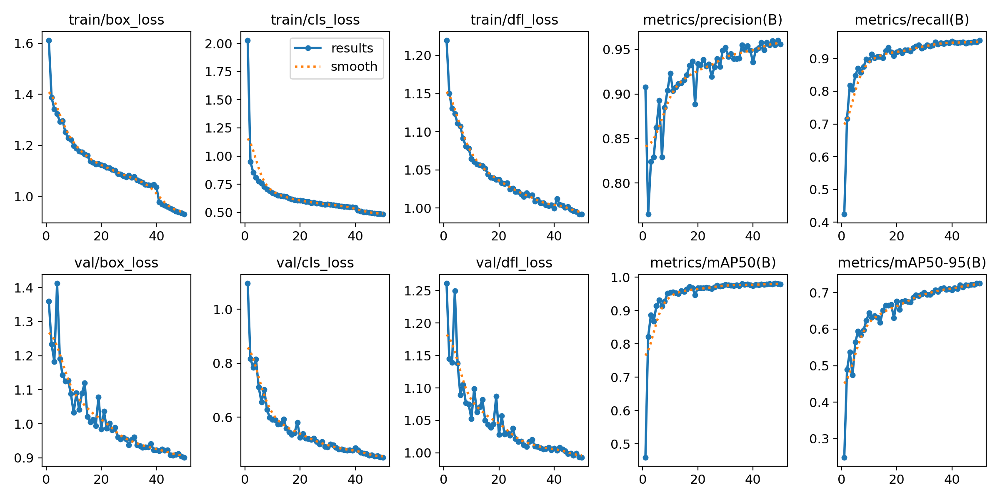

In [8]:
from IPython.display import Image
Image(filename='/content/runs/detect/train/results.png', width=600)

**Test**

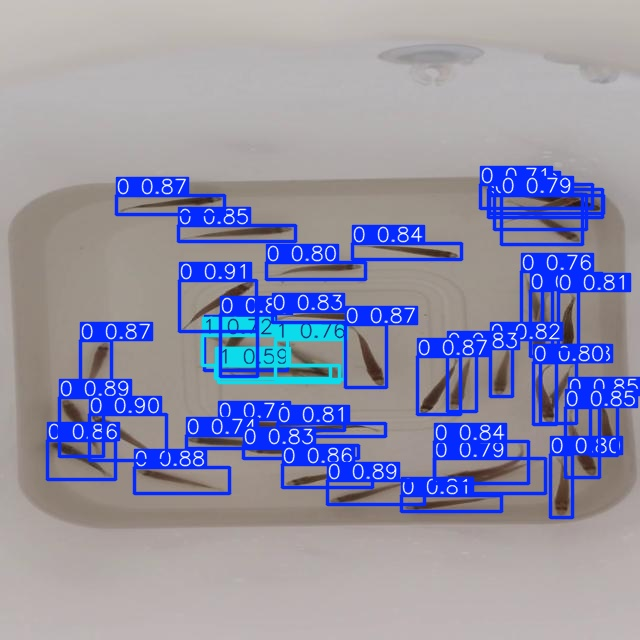

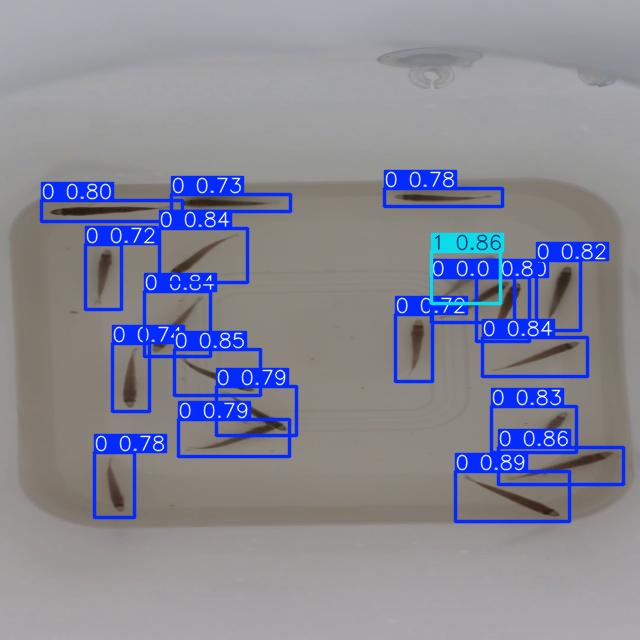

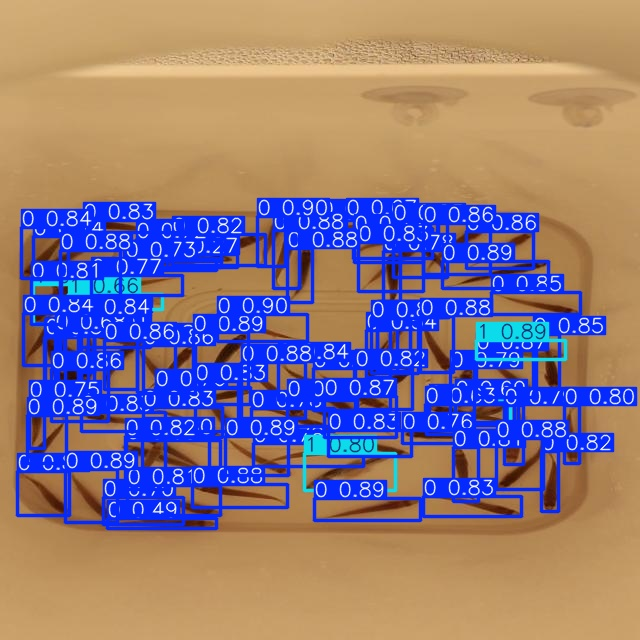

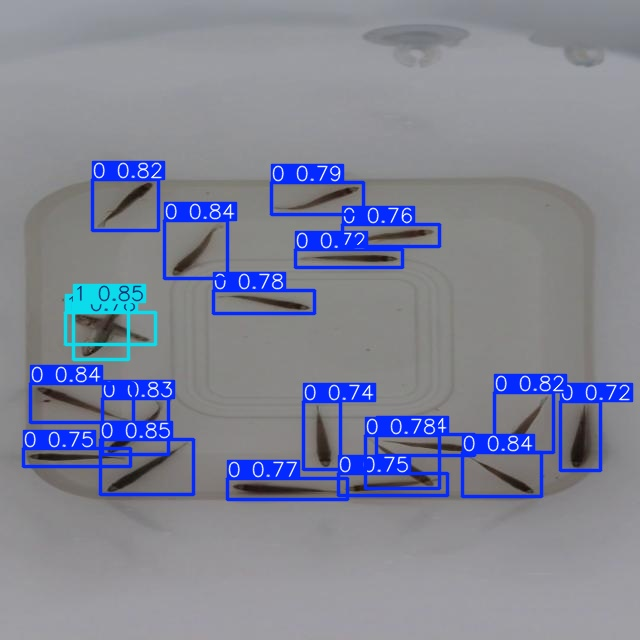

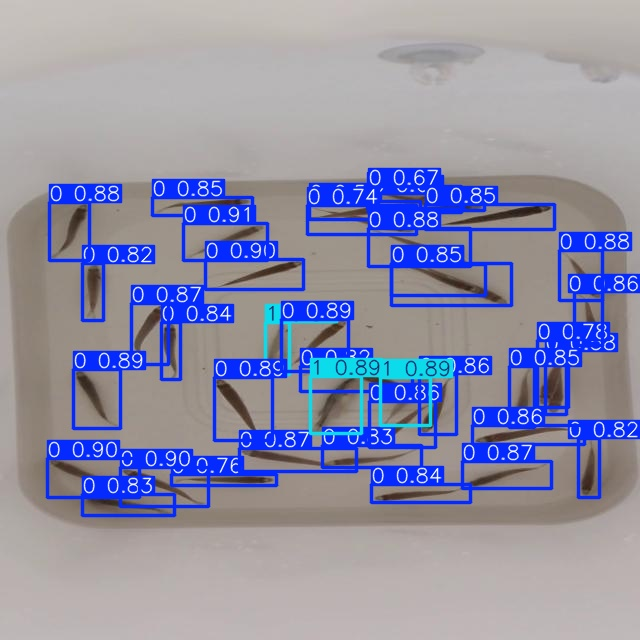

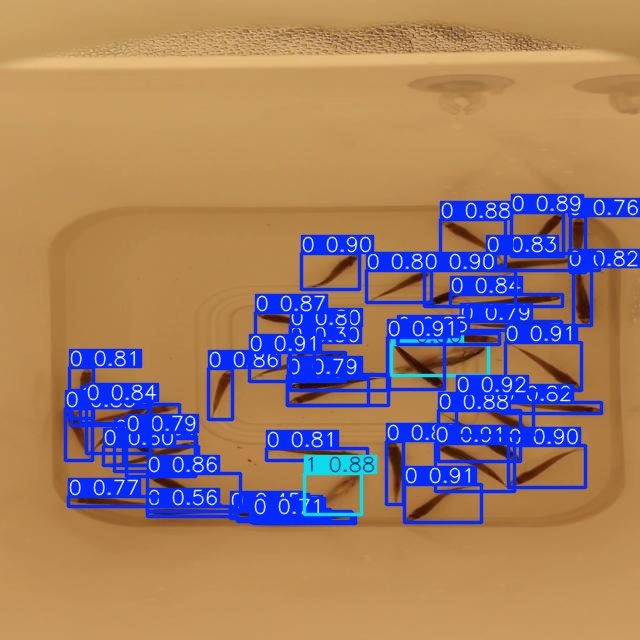

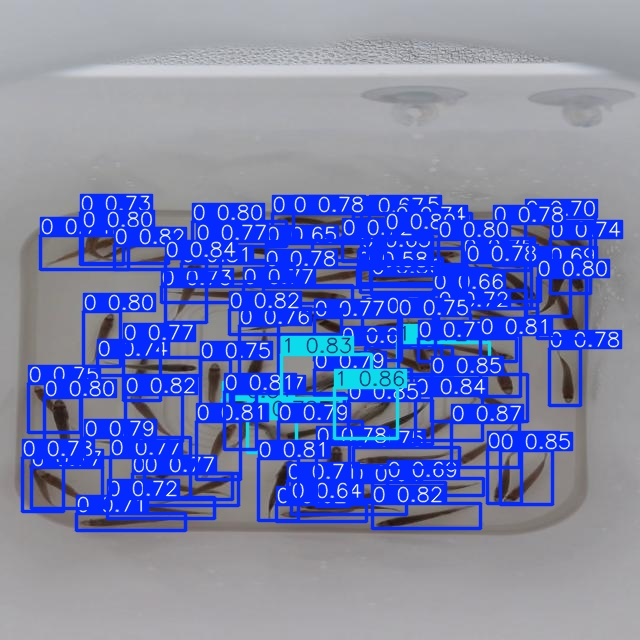

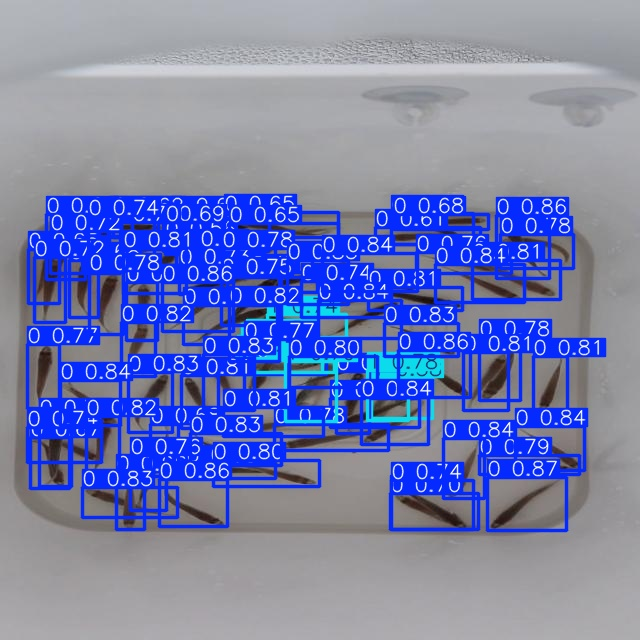

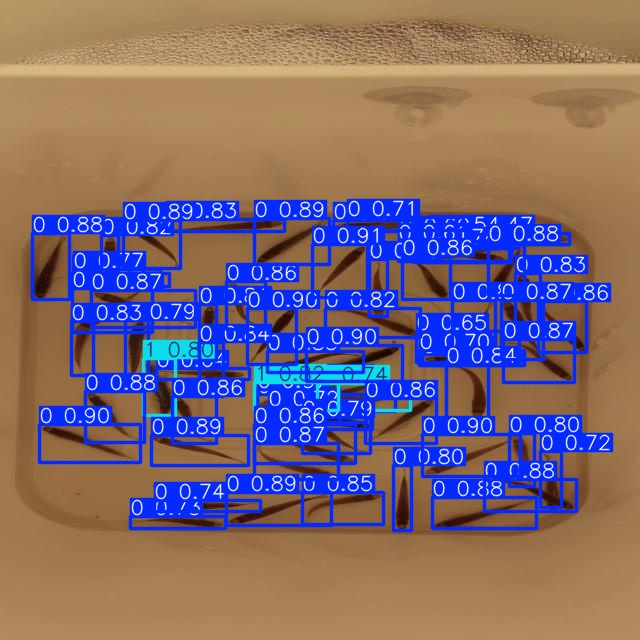

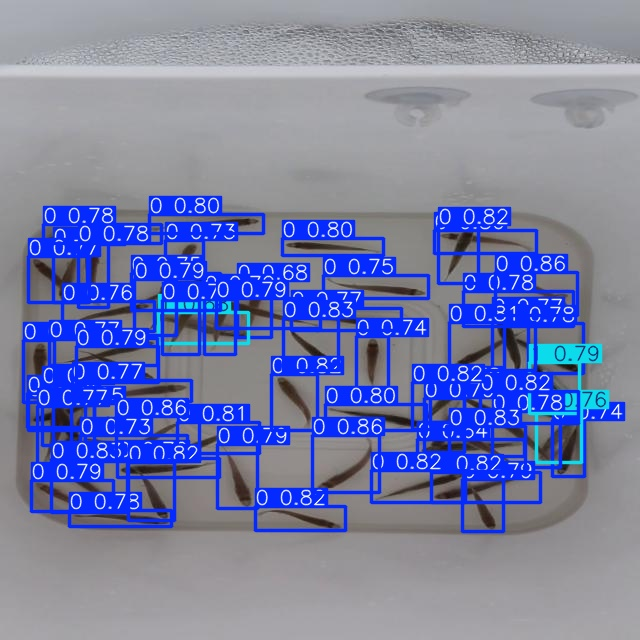

In [9]:
import glob
from IPython.display import Image, display
for image_path in glob.glob(f'/content/runs/detect/predict/*.jpg')[:10]:
  display(Image(filename=image_path, height=400))
  print('\n')

###**Test Target Data**



Fish-1.jpg: 485 boxes detected


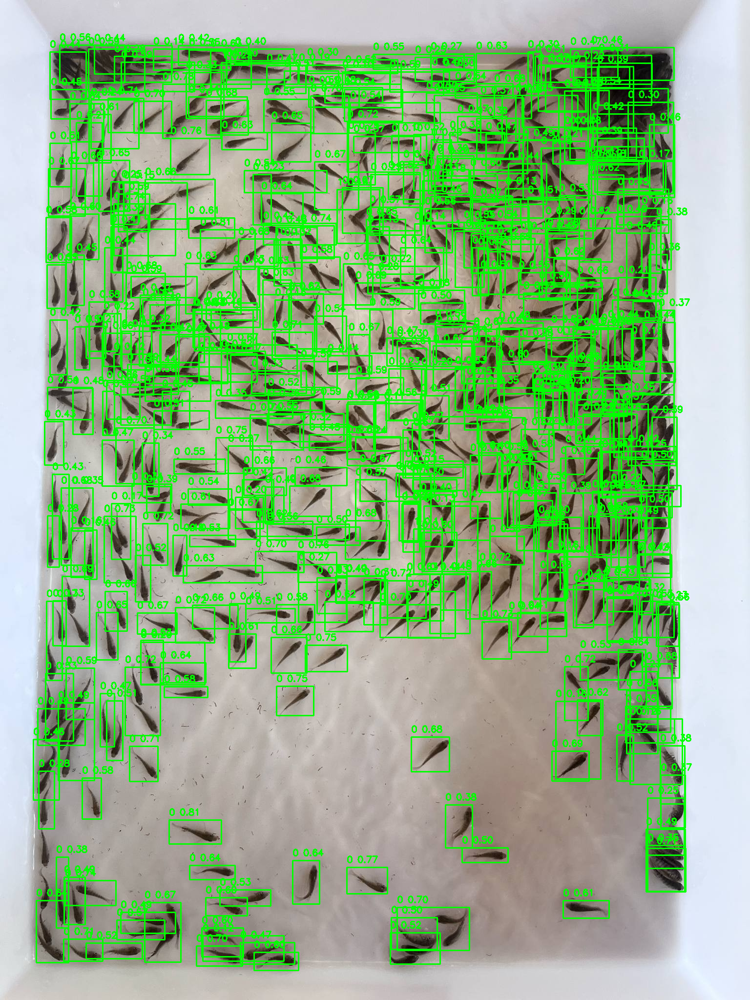

Fish-2.jpg: 476 boxes detected


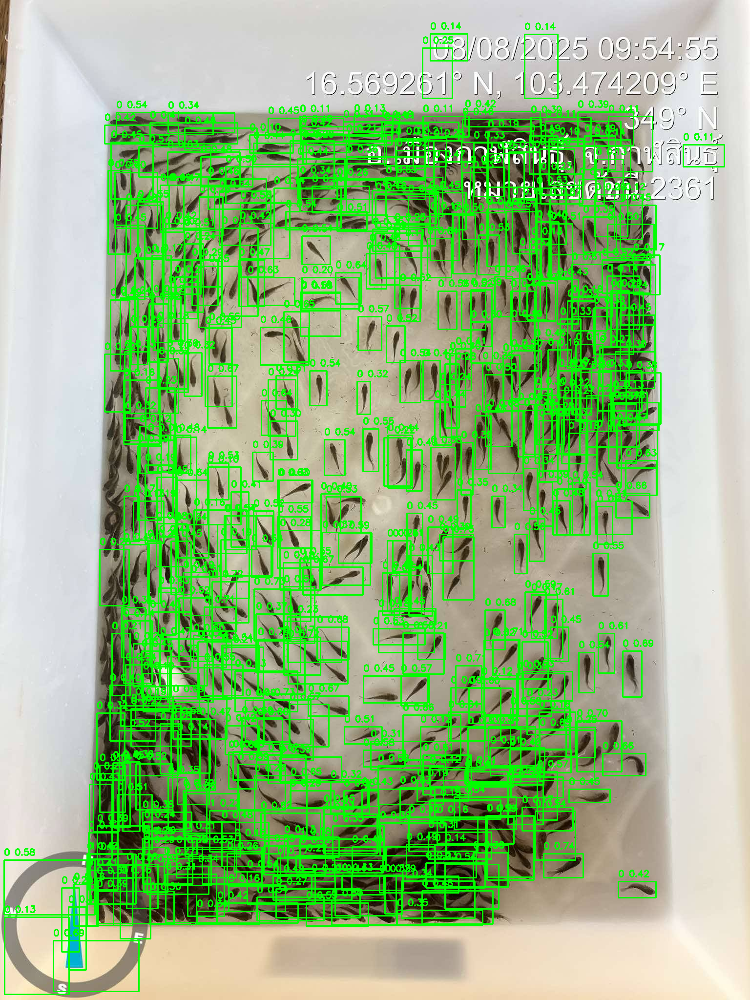

Fish-3.jpg: 511 boxes detected


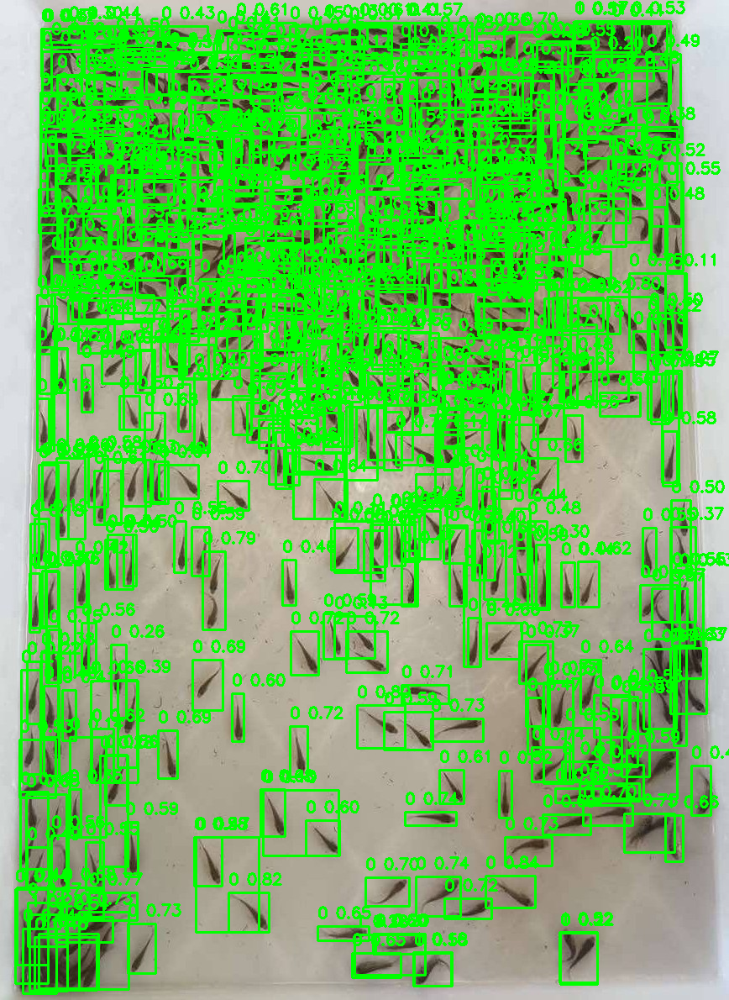

Fish-4.jpg: 485 boxes detected


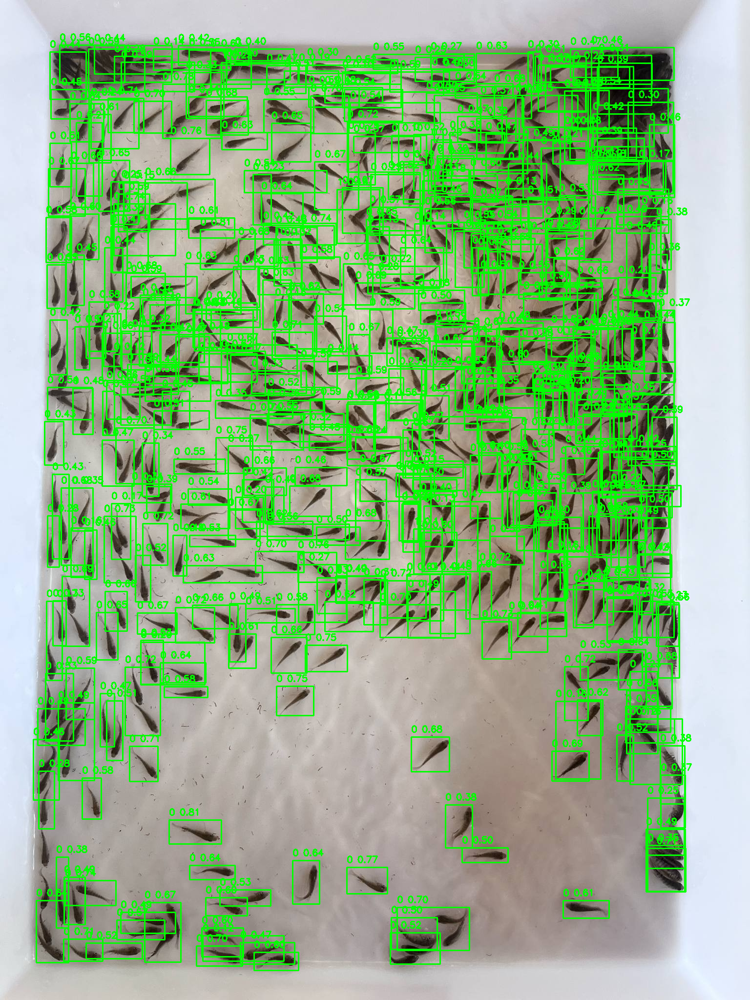

Fish-5.jpg: 480 boxes detected


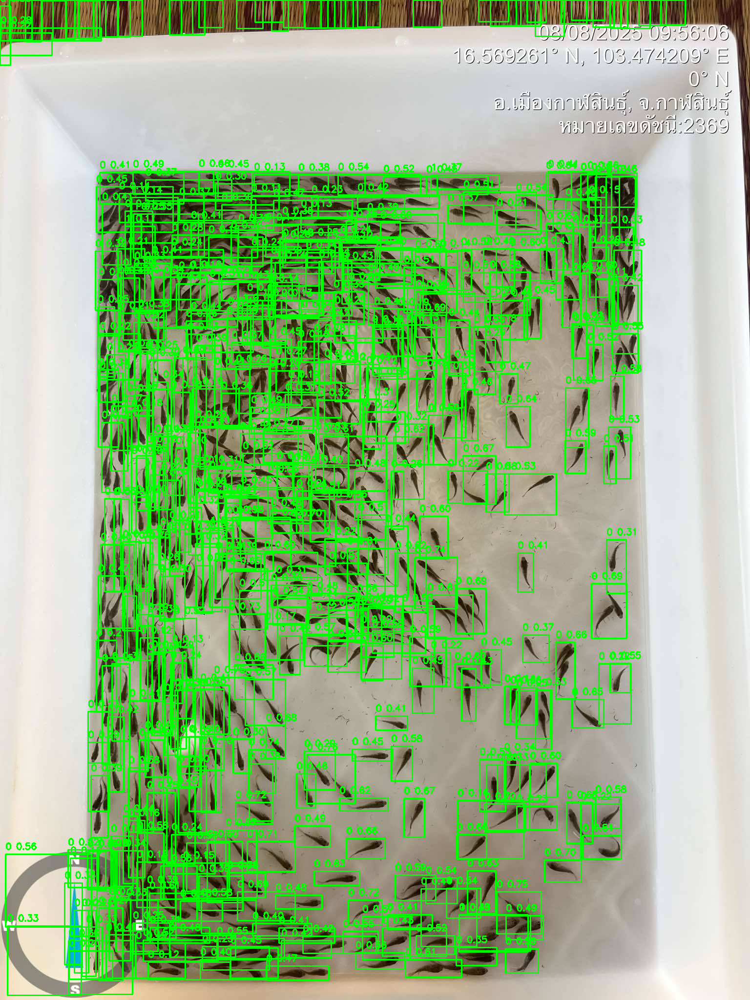

Fish-6.jpg: 521 boxes detected


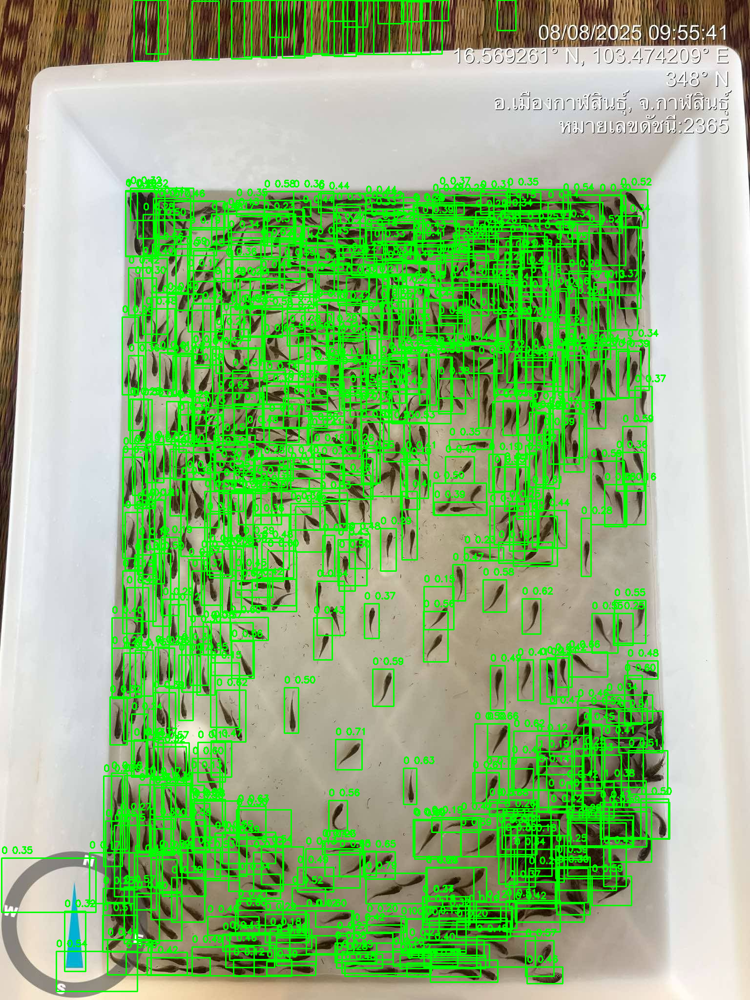

Fish-7.jpg: 508 boxes detected


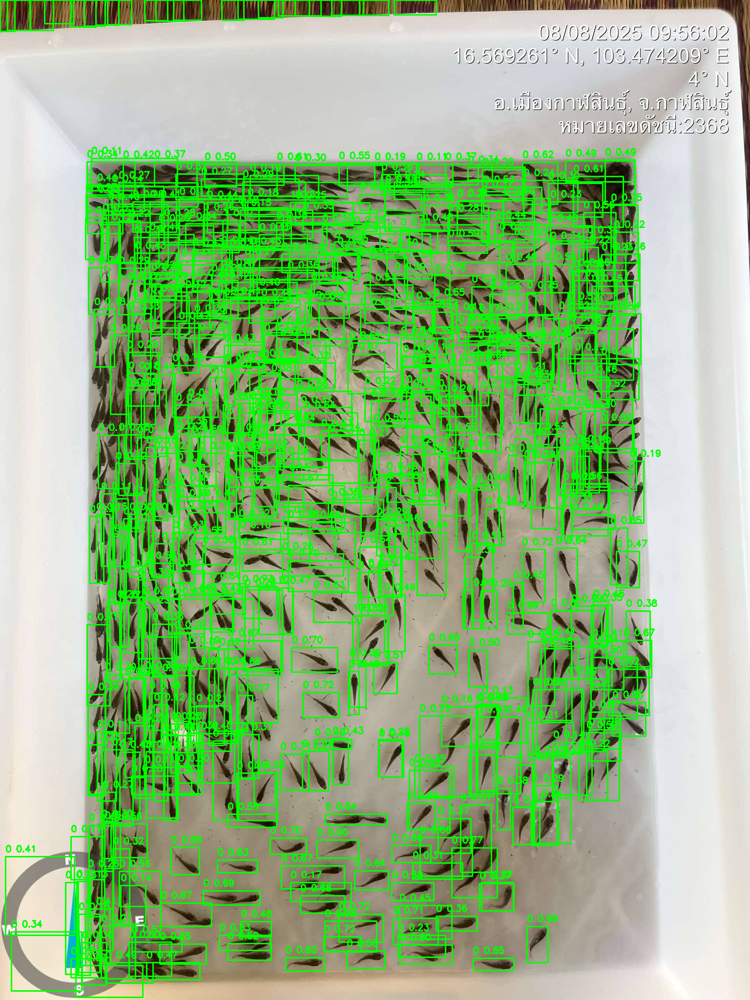

Fish-8.jpg: 537 boxes detected


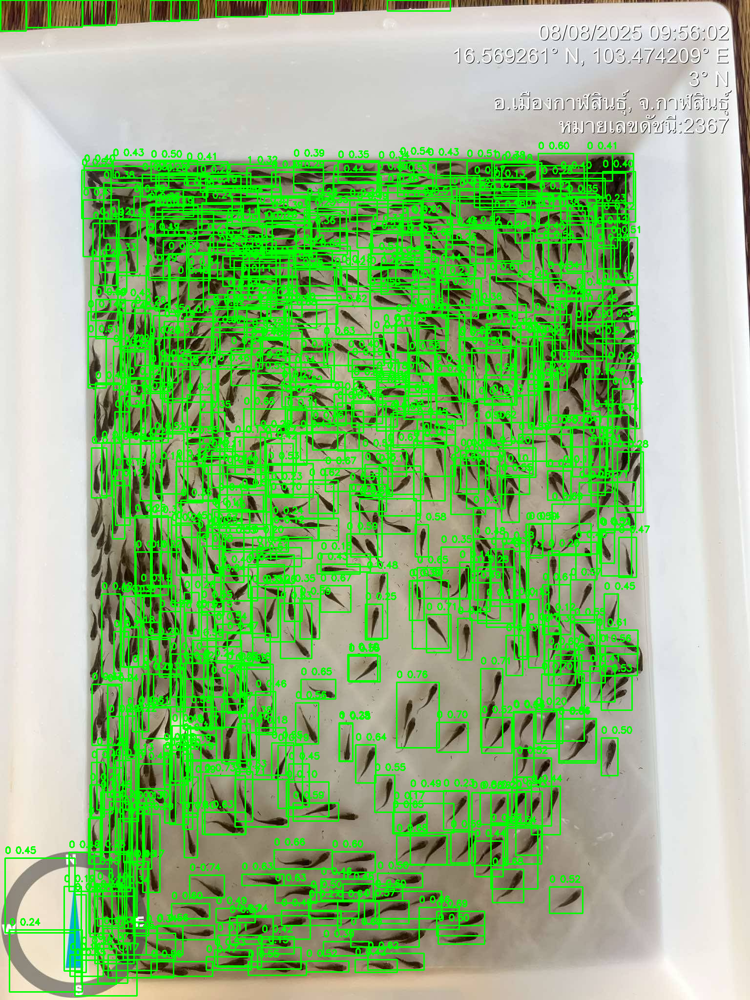

Fish-9.jpg: 508 boxes detected


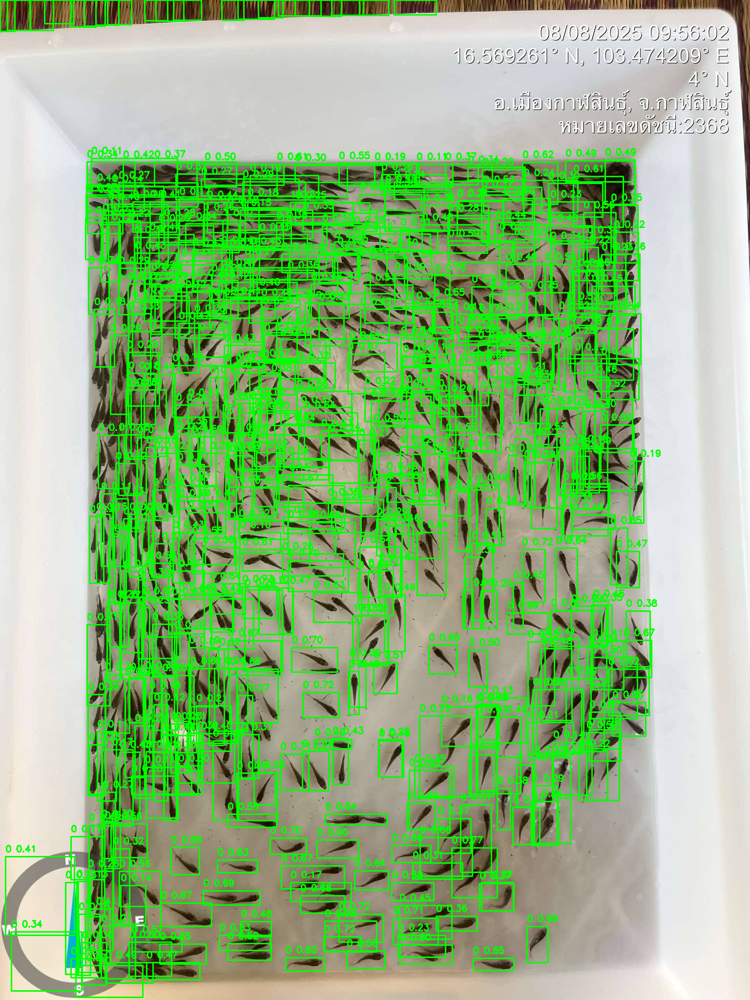

Fish-10.jpg: 445 boxes detected


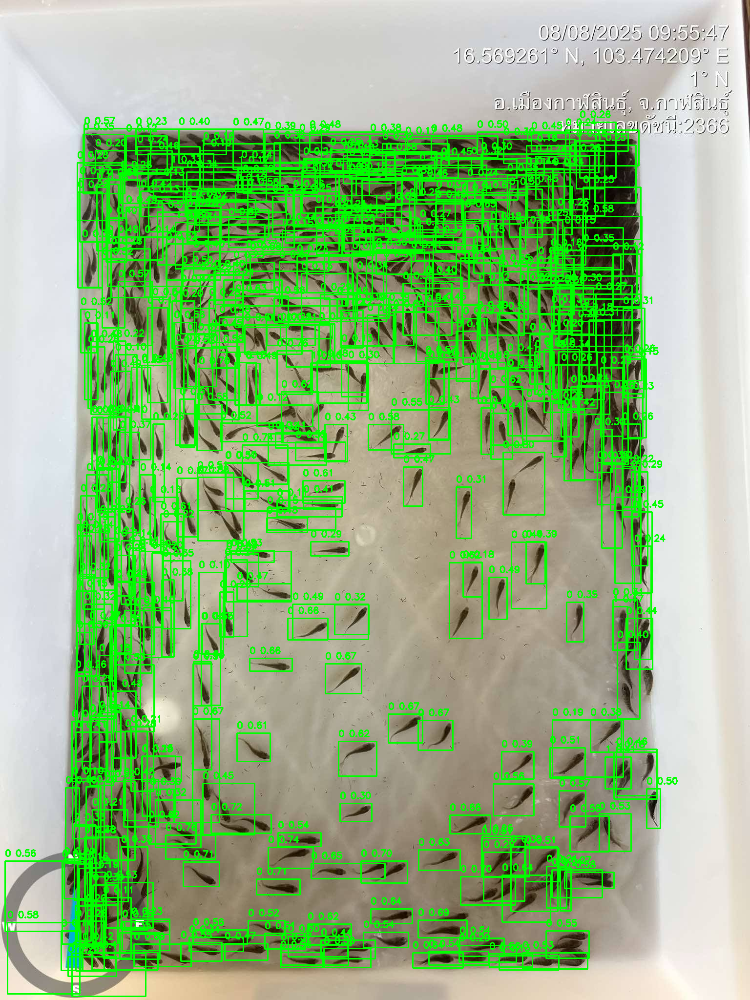


Total boxes detected in all images: 4956


In [11]:
from google.colab.patches import cv2_imshow

model = YOLO('/content/runs/detect/train/weights/best.pt')
test_folder = '/content/drive/MyDrive/Dataset'

total_boxes = 0
confidence_threshold = 0.1

for img_name in os.listdir(test_folder):
    if img_name.lower().endswith(('.jpg', '.jpeg', '.png')):
        img_path = os.path.join(test_folder, img_name)
        img = cv2.imread(img_path)

        results = model.predict(source=img,iou = 0.4, conf=confidence_threshold,max_det=1000, verbose=False)
        result = results[0]
        num_boxes = len(result.boxes)
        total_boxes += num_boxes
        for box in result.boxes:
            x1, y1, x2, y2 = map(int, box.xyxy[0])
            conf = float(box.conf[0])
            cls = int(box.cls[0])
            label = f"{model.names[cls]} {conf:.2f}"

            cv2.rectangle(img, (x1, y1), (x2, y2), (0,255,0), 2)
            cv2.putText(img, label, (x1, y1-10),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0,255,0), 2)

        print(f"{img_name}: {num_boxes} boxes detected")
        cv2_imshow(img)

print(f"\nTotal boxes detected in all images: {total_boxes}")

